In [1]:
import jax
import jax.random as jr
from jax import numpy as np
import numpy as onp

import pickle
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import HTML
import seaborn as sns
sns.set_context("poster")
sns.set_palette("RdYlBu", 8)
import time

import sys
sys.path.append("../src/")
import arm_model
from utils import plot_eigenvalues, plot_task_state
from ilqr_network_arm import init_radial_task, run_ilqr_batch


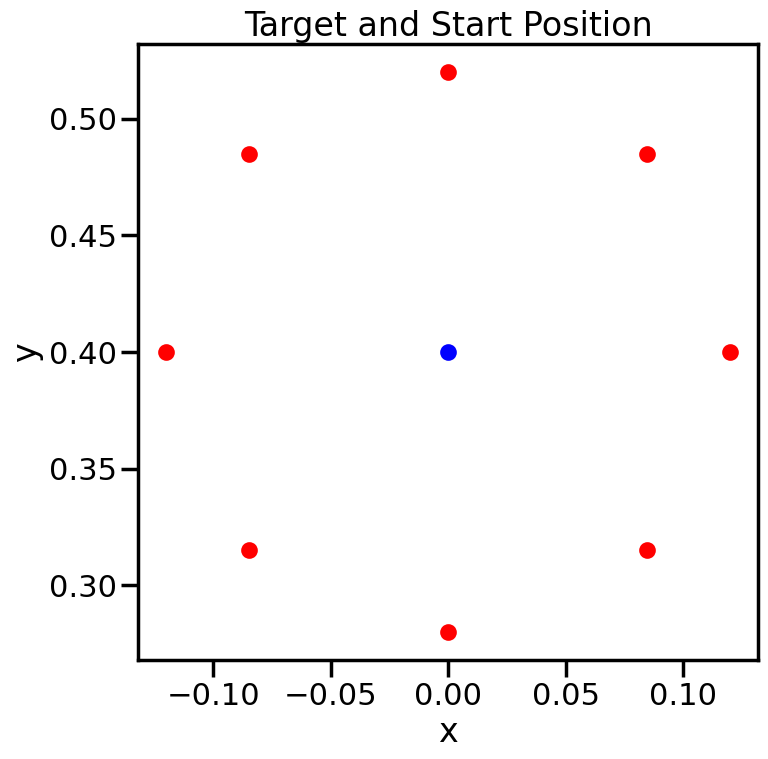

In [2]:
# Get target details
theta0, target_angles, target_pos = init_radial_task()

# Get starting position
start_pos = arm_model.get_arm_pos(theta0)

# Plot target locations and start position
plt.figure(figsize=(8, 8))
plt.scatter(target_pos[:,0], target_pos[:,1], s=100, c='r', label='Target')
plt.scatter(start_pos[0, 0], start_pos[0, 1], s=100, c='b', label='Start')
plt.xlabel('x')
plt.ylabel('y')
plt.title('Target and Start Position')
plt.show()

In [3]:
# Define Initial Conditions

# Load network data from file
with open("../data/network_s972356.pickle", 'rb') as handle:
    data = pickle.load(handle)

# Again, probably very dependent on initial condition of network
#NOTE: REMEMBER TO CHANGE THIS WHEN SWITCHING BACK AND FORTH
# h0 = data['xsp'][None].repeat(8, 0)
h0 = jr.normal(key=jr.PRNGKey(0), shape=(200,))[None].repeat(8, 0)

q0 = np.concatenate((theta0, np.zeros((2, ))))
q0 = np.repeat(q0[None], axis=0, repeats=8)
x0 = np.concatenate((np.zeros((8, 2)), h0, q0), axis=1)

# Define optimization hyperparameters
ALPHA_NULL = 1.
ALPHA_EFFORT = 1.E-5
lmbda = (ALPHA_NULL, ALPHA_EFFORT)
regu = 0
iterations = 10
total_time = 1200 #ms
# Define target trajectory (batch, timesteps, final state)
target_trj = np.repeat(np.expand_dims(target_angles, 1), total_time, axis=1)

Noting that I think there's a large intial input when init state is close to 0 because it is trying to get to a state close to the state that is being loaded from data file

In [4]:
# Run Optimization
t0 = time.time()
x_trj_new, u_trj_new, cost_trace = run_ilqr_batch(x0, target_trj, None, iterations, regu, lmbda)
y_trj = arm_model.get_position_batch(x_trj_new[:,:,-4:-2], False) 
t1 = time.time()
print(f"Optimization time: ~{t1-t0:1.0f} seconds")

Optimization time: ~126 seconds


In [5]:
x_trj_new.shape

(8, 1200, 206)

Text(0.5, 0.98, 'Cost Traces')

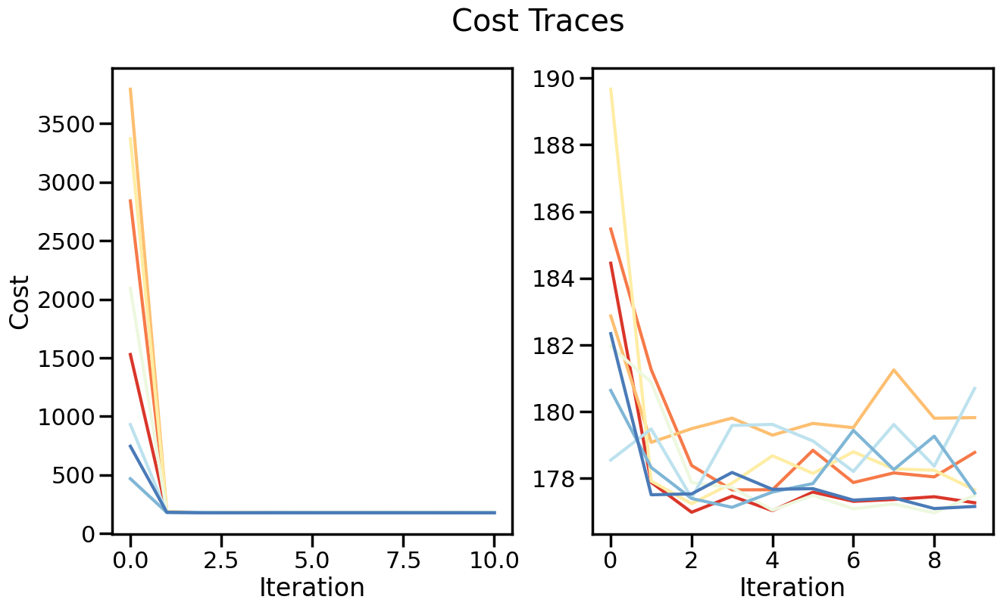

In [6]:
# Plot Cost Traces
fig, ax = plt.subplots(1, 2, figsize=(15, 8))
for i, trace in enumerate(cost_trace):
    ax[0].plot(trace, label=f'Reach {i+1}')
    ax[1].plot(trace[1:], label=f'Reach {i+1}')

ax[0].set_xlabel('Iteration')
ax[1].set_xlabel('Iteration')
ax[0].set_ylabel('Cost')
plt.suptitle('Cost Traces')

Visualize result

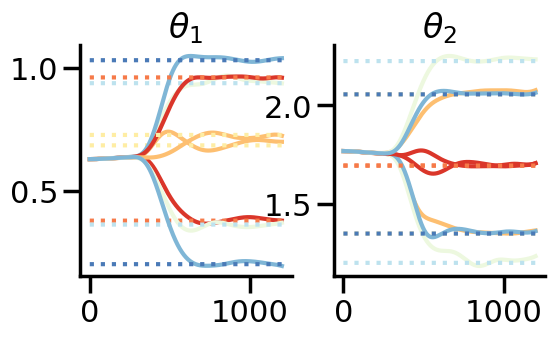

In [7]:
fig, ax = plt.subplots(1,2, figsize=(6,3))
for i in range(8):
    ax[0].plot(x_trj_new[i,:,-4])
    ax[1].plot(x_trj_new[i,:,-3])
    ax[0].plot(target_trj[i,:,0],":")
    ax[1].plot(target_trj[i,:,1],":")
    
ax[0].set_title(r"$\theta_1$")
ax[1].set_title(r"$\theta_2$")
sns.despine()

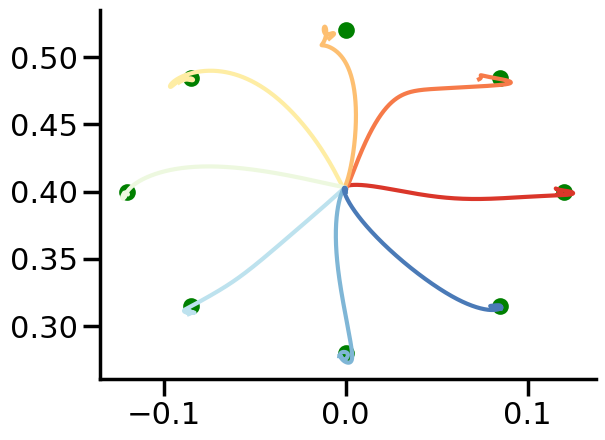

In [8]:
for i in range(8):
    plt.plot(y_trj[i,:,0],y_trj[i,:,1])
    # plt.plot(y_target[i,:,0], y_target[i,:,1], ":",color='gray')
plt.scatter(target_pos[:,0], target_pos[:,1], s=100, c='g')
sns.despine()

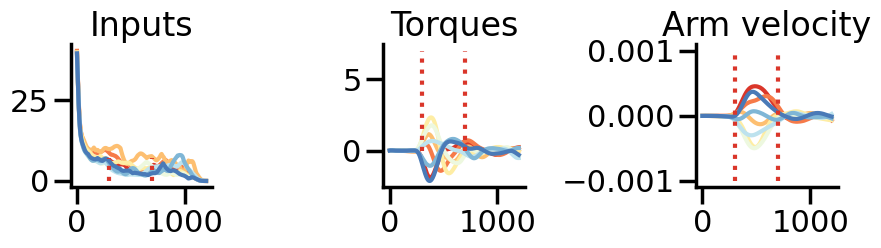

In [ ]:
f, ax = plt.subplots(1, 3, figsize=(9,3))

for i in range(8):
    # NOTE: Taking norm here
    ax[0].plot(np.linalg.norm(u_trj_new[i], axis=-1))
    ax[1].plot(x_trj_new[i,:,0]) # torque 1
    ax[2].plot(np.diff(y_trj[i,:,0])) # velocity 1
    
for i in range(2):
    ax[i].vlines(300, 0, 7,linestyles=":")
    ax[i].vlines(700, 0, 7,linestyles=":")
    
i = 2
ax[i].vlines(300, -0.001, 0.001,linestyles=":")
ax[i].vlines(700, -0.001, 0.001,linestyles=":")

    
ax[0].set_title("Inputs (Norm)")
ax[1].set_title("Torques")
ax[2].set_title("Arm velocity")
f.tight_layout()
sns.despine()

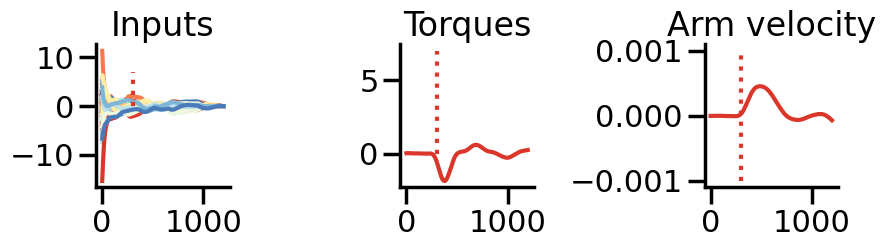

In [10]:
f, ax = plt.subplots(1, 3, figsize=(9,3))

for i in range(8):
    # NOTE: Taking norm here???
    ax[0].plot(u_trj_new[i,:,:])
    ax[1].plot(x_trj_new[i,:,0]) # torque 1
    ax[2].plot(np.diff(y_trj[i,:,0])) # velocity 1
    break
    
for i in range(2):
    ax[i].vlines(300, 0, 7,linestyles=":")
    # ax[i].vlines(700, 0, 7,linestyles=":")
    
i = 2
ax[i].vlines(300, -0.001, 0.001,linestyles=":")

ax[0].set_title("Inputs")
ax[1].set_title("Torques")
ax[2].set_title("Arm velocity")
f.tight_layout()
sns.despine()

### Create Animations

/opt/anaconda3/envs/ilqr/lib/python3.10/site-packages/jax/_src/numpy/array_methods.py:122: UserWarning: Explicitly requested dtype float64 requested in astype is not available, and will be truncated to dtype float32. To enable more dtypes, set the jax_enable_x64 configuration option or the JAX_ENABLE_X64 shell environment variable. See https://github.com/jax-ml/jax#current-gotchas for more.
  return lax_numpy.astype(self, dtype, copy=copy, device=device)
/opt/anaconda3/envs/ilqr/lib/python3.10/site-packages/jax/_src/numpy/lax_numpy.py:6487: UserWarning: Explicitly requested dtype float64 requested in array is not available, and will be truncated to dtype float32. To enable more dtypes, set the jax_enable_x64 configuration option or the JAX_ENABLE_X64 shell environment variable. See https://github.com/jax-ml/jax#current-gotchas for more.
  delta: Array = lax.convert_element_type(stop - start, computation_dtype) / array(div, dtype=computation_dtype)
/opt/anaconda3/envs/ilqr/lib/python3.1

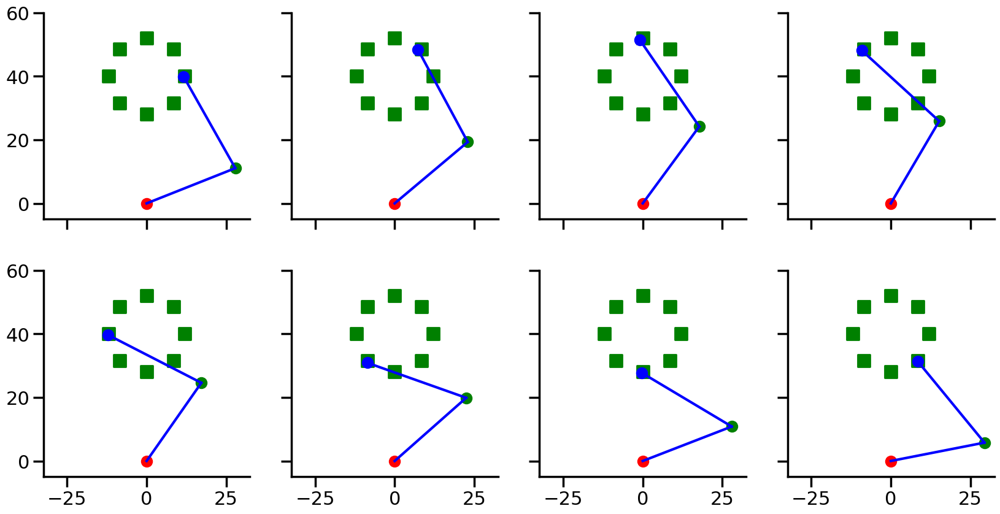

In [13]:
arm_trj = arm_model.get_position_batch(x_trj_new[:,:,-4:-2], True)

# Initialize figure for animation of 2-link arm
fig, ax = plt.subplots(2, 4, figsize=(20, 10), sharex=True, sharey=True)
axs = ax.flatten()

# Remove top and right spines
for i in range(8):
    axs[i].spines['top'].set_visible(False)
    axs[i].spines['right'].set_visible(False)
    axs[i].set_aspect('equal')

# Downsample trajectory for animation
num_f = 300
frame_idx = np.linspace(0, arm_trj.shape[1], num_f, dtype=int)
sampled_pos = arm_trj[:,frame_idx,:,:]

# Create animation
plot_frame = lambda f: plot_task_state(sampled_pos[:,f,:,:], target_pos, axs)
ani = FuncAnimation(fig, plot_frame, frames=num_f, interval=1, repeat=False)
HTML(ani.to_jshtml())

In [17]:
ani.frame_seq

In [15]:
# Save animation as GIF
# writer = PillowWriter(fps=400)
ani.save('arm_animation.gif', fps=400)

MovieWriter ffmpeg unavailable; using Pillow instead.


Noting:
- dt = 1.0 for network dynamics, dt = 0.01 for arm dynamics. Why?
- Results have large dependence on initial condition of neural network? Neural state h0 is huge (values in the 20s), tau is 150 not .150, hbar in network dynamics is also huge. Changing this with network weights maybe? Check the network weight values. 

Further inspect network weights -> In different notebook